# Caso 3: Aseguradora

## 1. Entendimiento del Problema

El equipo de tarifación de la aseguradora requiere pronósticar el valor de la prima de los aseguradores dentro de la compañía

## 2. Enfoque Analítico

Se debe construir un modelo de regresión que permita predecir la prima con un MAPE menor o igual al 15%

## 3. Requerimiento de Datos

- Se requieren los datos de los aseguradores dentro de la compañía

## 4. Recolección de Datos

- age: edad del asegurado
- sex: género del asegurado
- bmi: índice de masa corporal del asegurado
- children: número de hijos del asegurado
- smoker: el asegurado es o no es fumador
- region: región comercial a la que pertenece el asegurado
- charges: valor de la prima del asegurado

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import numpy as np
from ydata_profiling import ProfileReport

import warnings
warnings.filterwarnings('ignore')

In [3]:
data = pd.read_csv('datos_caso_3.csv')
data

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


### EDA YData Profiling

In [5]:
profile = ProfileReport(data, title="Caso Regresión", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:00<00:00, 1679.93it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 5. Entendimiento de los Datos

### Valores Nulos

<Axes: >

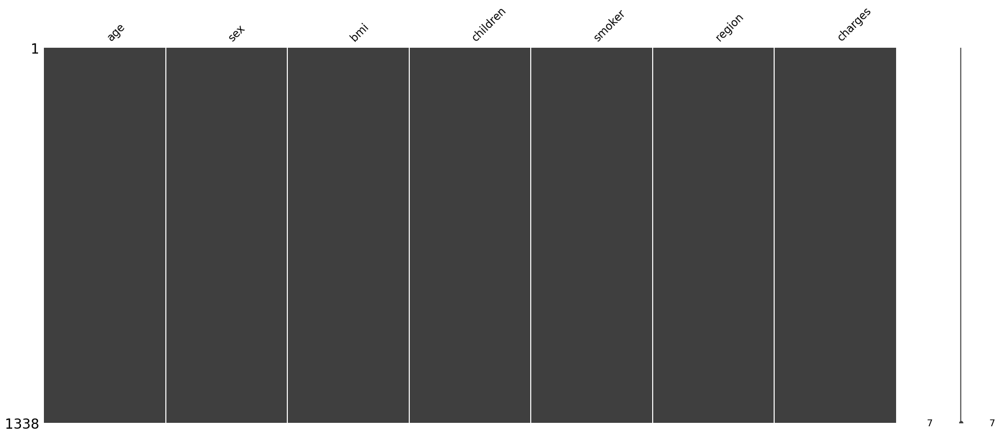

In [3]:
msno.matrix(data)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


### Análisis Variable Y

- Posee un comportamiento normal al tratarse de temas financieros con una curva exponencial

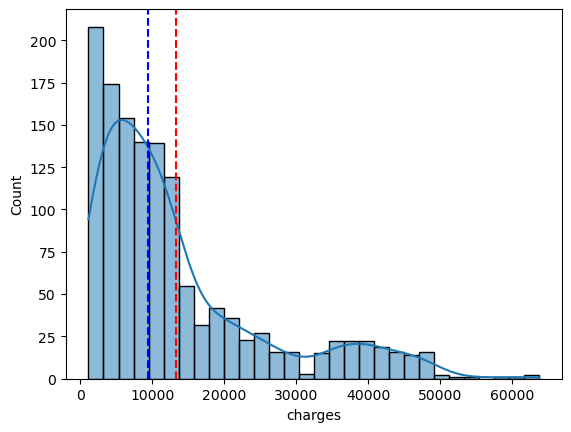

In [5]:
sns.histplot(data, x = "charges", kde=True)
plt.axvline(data["charges"].mean(), color='red', linestyle='--')
plt.axvline(data["charges"].median(), color='blue', linestyle='--')
plt.show()

### Histogramas de Frecuencia

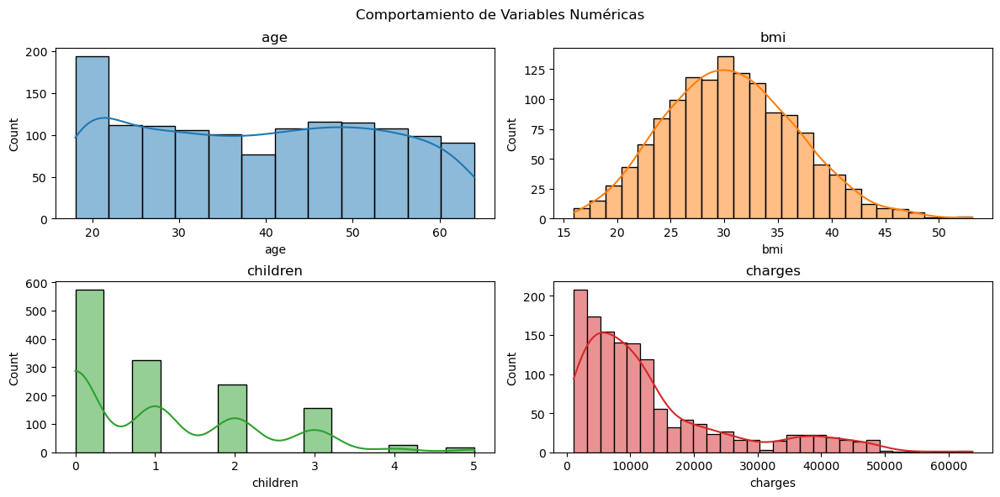

In [6]:
fig, ax = plt.subplots(2, 2, figsize = (12, 6))
ax = ax.flat
num_col = data.select_dtypes(include = ['int64', 'float64']).columns
for i, col in enumerate(num_col):
    sns.histplot(data = data, x = col, 
                kde = True, color = (list(plt.rcParams['axes.prop_cycle']) * 7)[i]['color'], ax = ax[i])
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle('Comportamiento de Variables Numéricas')
plt.show()

### Gráficos de Torta

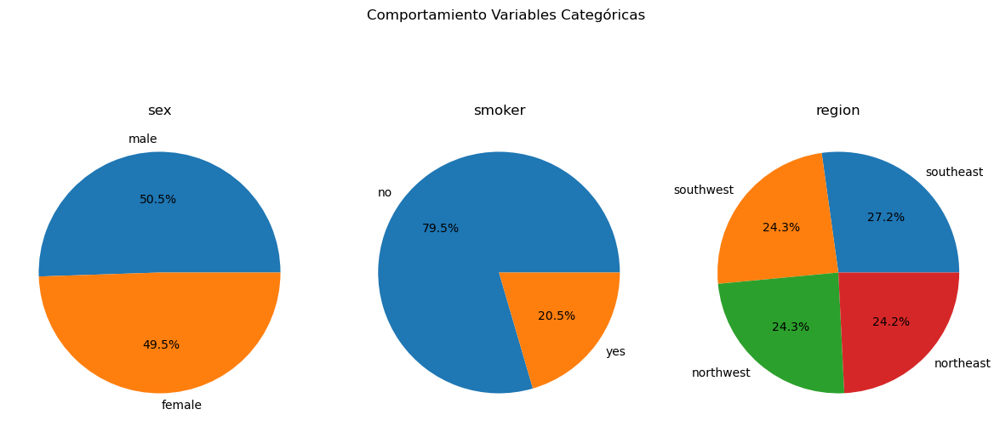

In [7]:
fig, ax = plt.subplots(1, 3, figsize = (12, 6))
ax = ax.flat
cat_col = data.select_dtypes(include = ['object']).columns
for i, col in enumerate(cat_col):
    ax[i].pie(x = data[col].value_counts(), labels = data[col].value_counts().index, autopct = '%0.1f%%')
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle("Comportamiento Variables Categóricas")
plt.show()

### Factor de Correlación

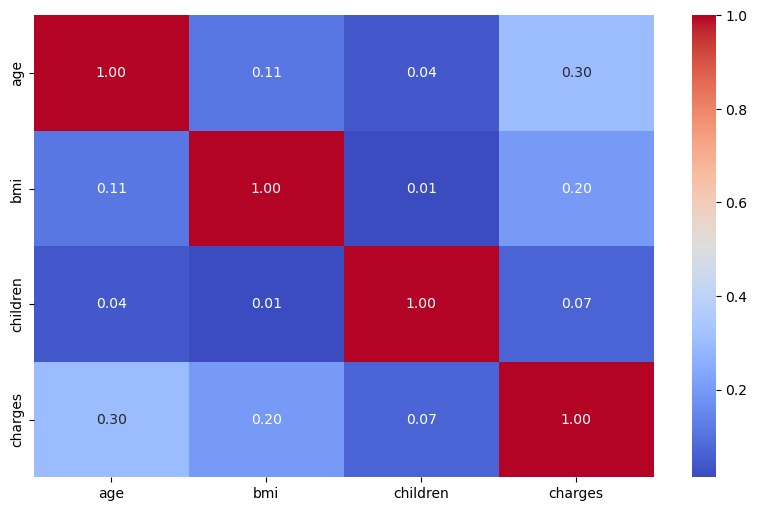

In [8]:
plt.figure(figsize = (10, 6))
sns.heatmap(data.corr(numeric_only=True), annot=True, fmt=".2f", cmap="coolwarm")
plt.show()

## 6. Preparación de los datos

In [3]:
data_clean = data.drop(columns = ['smoker'])
data_clean

,age,sex,bmi,children,region,charges
0,19,female,27.900,0,southwest,16884.92400
1,18,male,33.770,1,southeast,1725.55230
2,28,male,33.000,3,southeast,4449.46200
3,33,male,22.705,0,northwest,21984.47061
4,32,male,28.880,0,northwest,3866.85520
...,...,...,...,...,...,...
1333,50,male,30.970,3,northwest,10600.54830
1334,18,female,31.920,0,northeast,2205.98080
1335,18,female,36.850,0,southeast,1629.83350
1336,21,female,25.800,0,southwest,2007.94500


In [4]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.pipeline import Pipeline

### Transformación de los Datos

In [5]:
num_col = data_clean.select_dtypes(include = ['int64', 'float64']).columns
cat_col = data_clean.select_dtypes(include = ['object']).columns

num_trans = Pipeline(steps = [('scaler', MinMaxScaler())])
cat_trans = Pipeline(steps = [('onehot', OneHotEncoder())])

preprocessor = ColumnTransformer(transformers = [
    ('num', num_trans, num_col),
    ('cat', cat_trans, cat_col)
])

preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('scaler', MinMaxScaler())]),
                                 Index(['age', 'bmi', 'children', 'charges'], dtype='object')),
                                ('cat',
                                 Pipeline(steps=[('onehot', OneHotEncoder())]),
                                 Index(['sex', 'region'], dtype='object'))])

In [6]:
data_pre = preprocessor.fit_transform(data_clean)
cod_cat = preprocessor.named_transformers_['cat']['onehot'].get_feature_names_out(cat_col)
labels = np.concatenate([num_col, cod_cat])
data_pro = pd.DataFrame(data_pre, columns = labels)
data_pro = data_pro[(data_pro['charges'] != 0)]
data_pro

,age,bmi,children,charges,sex_female,sex_male,region_northeast,region_northwest,region_southeast,region_southwest
0,0.021739,0.321227,0.0,0.251611,1.0,0.0,0.0,0.0,0.0,1.0
1,0.000000,0.479150,0.2,0.009636,0.0,1.0,0.0,0.0,1.0,0.0
2,0.217391,0.458434,0.6,0.053115,0.0,1.0,0.0,0.0,1.0,0.0
3,0.326087,0.181464,0.0,0.333010,0.0,1.0,0.0,1.0,0.0,0.0
4,0.304348,0.347592,0.0,0.043816,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
1333,0.695652,0.403820,0.6,0.151299,0.0,1.0,0.0,1.0,0.0,0.0
1334,0.000000,0.429379,0.0,0.017305,1.0,0.0,1.0,0.0,0.0,0.0
1335,0.000000,0.562012,0.0,0.008108,1.0,0.0,0.0,0.0,1.0,0.0
1336,0.065217,0.264730,0.0,0.014144,1.0,0.0,0.0,0.0,0.0,1.0


### Conjunto de Entrenamiento

- Debido a que la evaluación se va a realizar mediante MAPE se eliminó el único registro que tenía un 0 dentro de la variable Y (Charges) para poder medirlo bien y que no tienda a infinito

In [7]:
from sklearn.model_selection import train_test_split

El tamaño del conjunto de entrenamiento es: 935 935
El tamaño del conjunto de prueba es: 402 402


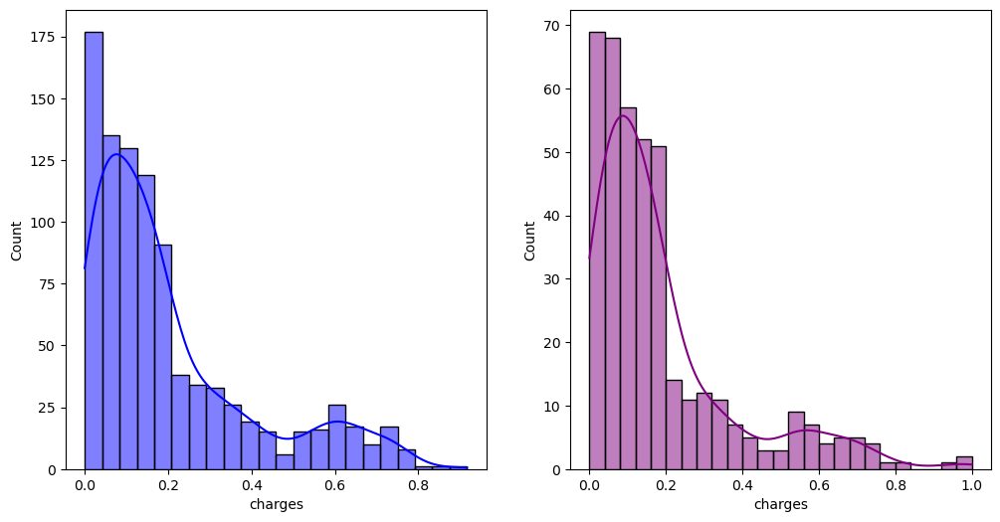

In [8]:
X = data_pro.drop(columns = ['charges'])
y = data_pro['charges']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, random_state = 123)
print(f'El tamaño del conjunto de entrenamiento es: {X_train.shape[0]} {y_train.shape[0]}')
print(f'El tamaño del conjunto de prueba es: {X_test.shape[0]} {y_test.shape[0]}')
fig, ax = plt.subplots(1, 2, figsize = (12, 6))
sns.histplot(y_train, kde = True, color = 'blue', ax = ax[0])
sns.histplot(y_test, kde = True, color = 'purple', ax = ax[1])
plt.show()

## 7. Modelos

In [14]:
from sklearn.metrics import r2_score, mean_absolute_error, root_mean_squared_error, mean_absolute_percentage_error, make_scorer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [15]:
def wmape(y_true, y_pred):
    # Weighted MAPE = sum(|y-ŷ|) / sum(|y|)
    denom = np.sum(np.abs(y_true))
    return np.sum(np.abs(y_true - y_pred)) / np.maximum(denom, 1e-12)

scorer_wmape = make_scorer(wmape, greater_is_better = False)

### Regresión Lineal

In [16]:
from sklearn.linear_model import LinearRegression

In [17]:
modelo_1 = LinearRegression()
modelo_1.fit(X_train, y_train)

LinearRegression()

In [18]:
modelo_1.intercept_

np.float64(0.02602025870850727)

In [19]:
modelo_1.coef_

array([ 0.17461564,  0.20330381,  0.04921954, -0.01074393,  0.01074393,
        0.0137659 , -0.00866701,  0.01638787, -0.02148676])

In [20]:
pred_train_1 = modelo_1.predict(X_train)
pred_test_1 = modelo_1.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_1 = pred_train_1 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_1 = pred_test_1 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.13126812074290328
MAE entrenamiento: 0.14631432509422354
RMSE entrenamiento: 0.1816800902956023
MAPE entrenamiento: 4.4657962263124675


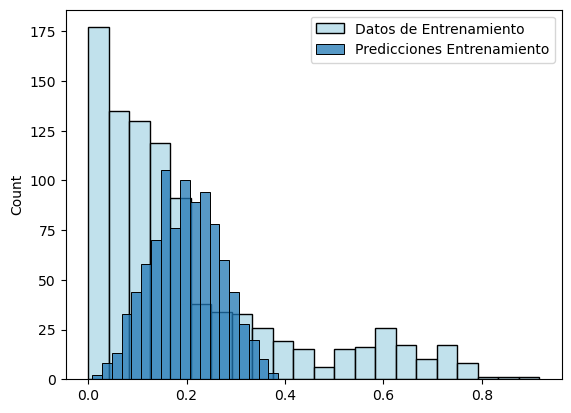

In [21]:
r2_train_1 = r2_score(y_train_desc, pred_train_desc_1)
mae_train_1 = mean_absolute_error(y_train_desc, pred_train_desc_1)
rmse_train_1 = root_mean_squared_error(y_train_desc, pred_train_desc_1)
mape_train_1 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_1)

print(f'R2 entrenamiento: {r2_train_1}')
print(f'MAE entrenamiento: {mae_train_1}')
print(f'RMSE entrenamiento: {rmse_train_1}')
print(f'MAPE entrenamiento: {mape_train_1}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_1.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.10438080313566822
MAE prueba: 0.13932919385211773
RMSE prueba: 0.1786274408873479
MAPE prueba: 4.641546005490532


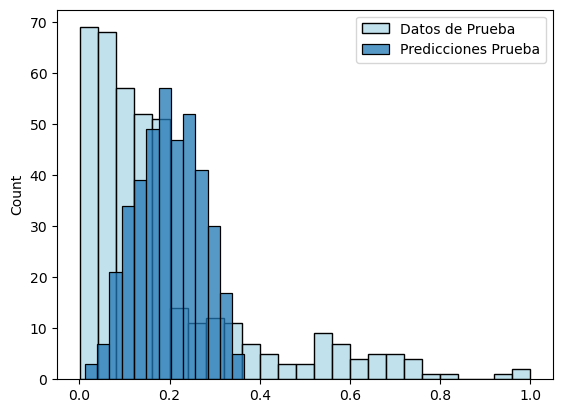

In [22]:
r2_test_1 = r2_score(y_test_desc, pred_test_desc_1)
mae_test_1 = mean_absolute_error(y_test_desc, pred_test_desc_1)
rmse_test_1 = root_mean_squared_error(y_test_desc, pred_test_desc_1)
mape_test_1 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_1)

print(f'R2 prueba: {r2_test_1}')
print(f'MAE prueba: {mae_test_1}')
print(f'RMSE prueba: {rmse_test_1}')
print(f'MAPE prueba: {mape_test_1}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_1.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### K Vecinos Mas Cercanos

In [12]:
from sklearn.neighbors import KNeighborsRegressor

In [16]:
modelo_2 = KNeighborsRegressor()
param_grid = {'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100], 'p': [1, 2]}
reg_2 = GridSearchCV(modelo_2, param_grid, cv = 5, n_jobs = -1, scoring = scorer_wmape)
reg_2.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsRegressor(), n_jobs=-1,
             param_grid={'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100],
                         'p': [1, 2]},
             scoring=make_scorer(wmape, greater_is_better=False, response_method='predict'))

In [17]:
validation = pd.concat([pd.DataFrame(reg_2.cv_results_['params']), 
                        pd.DataFrame(reg_2.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,n_neighbors,p,MAPE
4,5,1,-0.718445
2,3,1,-0.720477
3,3,2,-0.724460
7,7,2,-0.725923
5,5,2,-0.726086
6,7,1,-0.729846
8,11,1,-0.731758
9,11,2,-0.732726
10,21,1,-0.733811
11,21,2,-0.735152


In [18]:
modelo_2_final = reg_2.best_estimator_
modelo_2_final

KNeighborsRegressor(p=1)

In [19]:
pred_train_2 = modelo_2_final.predict(X_train)
pred_test_2 = modelo_2_final.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_2 = pred_train_2 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_2 = pred_test_2 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.3459359583125451
MAE entrenamiento: 0.11333729023671632
RMSE entrenamiento: 0.1576429649547384
MAPE entrenamiento: 2.9422636166072027


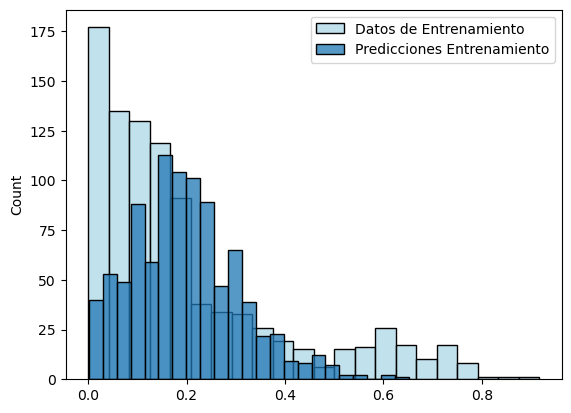

In [20]:
r2_train_2 = r2_score(y_train_desc, pred_train_desc_2)
mae_train_2 = mean_absolute_error(y_train_desc, pred_train_desc_2)
rmse_train_2 = root_mean_squared_error(y_train_desc, pred_train_desc_2)
mape_train_2 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_2)

print(f'R2 entrenamiento: {r2_train_2}')
print(f'MAE entrenamiento: {mae_train_2}')
print(f'RMSE entrenamiento: {rmse_train_2}')
print(f'MAPE entrenamiento: {mape_train_2}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_2.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.08472190837973348
MAE prueba: 0.14306526057302582
RMSE prueba: 0.19658287639158378
MAPE prueba: 3.634024294908549


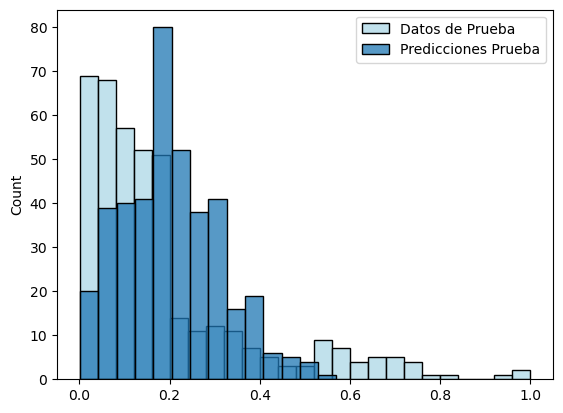

In [21]:
r2_test_2 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_2 = mean_absolute_error(y_test_desc, pred_test_desc_2)
rmse_test_2 = root_mean_squared_error(y_test_desc, pred_test_desc_2)
mape_test_2 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_2)

print(f'R2 prueba: {r2_test_2}')
print(f'MAE prueba: {mae_test_2}')
print(f'RMSE prueba: {rmse_test_2}')
print(f'MAPE prueba: {mape_test_2}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_2.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### MSV

In [22]:
from sklearn.svm import SVR

In [23]:
modelo_3 = SVR()
param_grid = {'C': [0.01, 0.1, 1, 10, 100], 'kernel': ['linear', 'poly', 'rbf'], 'degree': [2, 3, 4]}
reg_3 = GridSearchCV(modelo_3, param_grid, cv = 5, n_jobs = -1, scoring = scorer_wmape)
reg_3.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_3.cv_results_['params']), 
                        pd.DataFrame(reg_3.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,C,degree,kernel,MAPE
8,0.01,4,rbf,-0.714176
2,0.01,2,rbf,-0.714176
5,0.01,3,rbf,-0.714176
0,0.01,2,linear,-0.727736
3,0.01,3,linear,-0.727736
6,0.01,4,linear,-0.727736
12,0.10,3,linear,-0.730345
9,0.10,2,linear,-0.730345
15,0.10,4,linear,-0.730345
39,100.00,3,linear,-0.730397


In [24]:
modelo_3_final = reg_3.best_estimator_
modelo_3_final

SVR(C=0.01, degree=2)

In [25]:
pred_train_3 = modelo_3_final.predict(X_train)
pred_test_3 = modelo_3_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_3 = pred_train_3 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_3 = pred_test_3 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.08404523424632526
MAE entrenamiento: 0.14215463994533856
RMSE entrenamiento: 0.18655267077194299
MAPE entrenamiento: 3.624005096793513


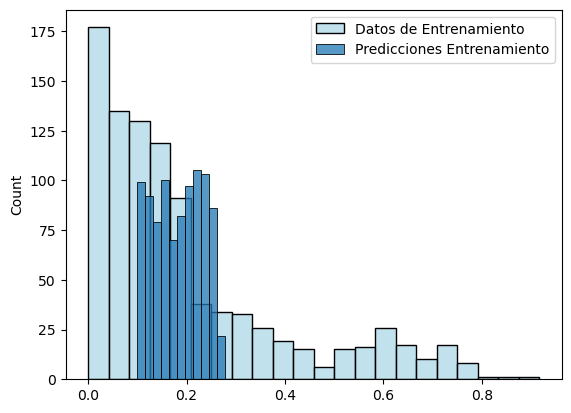

In [26]:
r2_train_3 = r2_score(y_train_desc, pred_train_desc_3)
mae_train_3 = mean_absolute_error(y_train_desc, pred_train_desc_3)
rmse_train_3 = root_mean_squared_error(y_train_desc, pred_train_desc_3)
mape_train_3 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_3)

print(f'R2 entrenamiento: {r2_train_3}')
print(f'MAE entrenamiento: {mae_train_3}')
print(f'RMSE entrenamiento: {rmse_train_3}')
print(f'MAPE entrenamiento: {mape_train_3}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_3.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.08472190837973348
MAE prueba: 0.13404650991952138
RMSE prueba: 0.17942028833113055
MAPE prueba: 3.4935868360987907


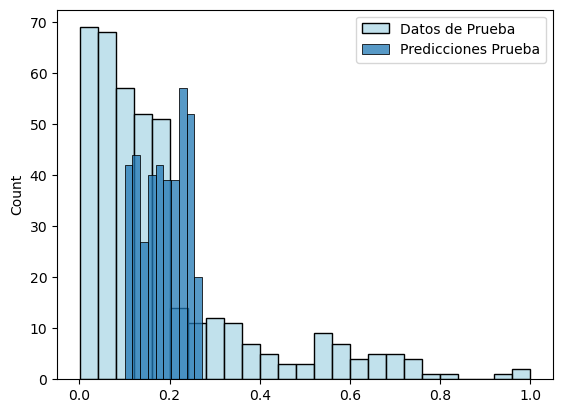

In [27]:
r2_test_3 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_3 = mean_absolute_error(y_test_desc, pred_test_desc_3)
rmse_test_3 = root_mean_squared_error(y_test_desc, pred_test_desc_3)
mape_test_3 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_3)

print(f'R2 prueba: {r2_test_3}')
print(f'MAE prueba: {mae_test_3}')
print(f'RMSE prueba: {rmse_test_3}')
print(f'MAPE prueba: {mape_test_3}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_3.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Árboles de Decisión

In [28]:
from sklearn.tree import DecisionTreeRegressor

In [29]:
modelo_4 = DecisionTreeRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'], 'max_depth': [None, 5, 10, 20], 'min_samples_split': [2, 3], 'max_leaf_nodes': [None, 2, 3, 4]}
reg_4 = GridSearchCV(modelo_4, param_grid, cv=3, scoring=scorer_wmape)
reg_4.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_4.cv_results_['params']), 
                        pd.DataFrame(reg_4.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,min_samples_split,MAPE
127,absolute_error,20.0,4.0,3,-0.583095
126,absolute_error,20.0,4.0,2,-0.583095
111,absolute_error,5.0,4.0,3,-0.583095
110,absolute_error,5.0,4.0,2,-0.583095
103,absolute_error,NaN,4.0,3,-0.583095
...,...,...,...,...,...
16,friedman_mse,10.0,NaN,2,-0.801838
17,friedman_mse,10.0,NaN,3,-0.801945
81,squared_error,10.0,NaN,3,-0.803686
88,squared_error,20.0,NaN,2,-0.807470


In [30]:
modelo_4_final = reg_4.best_estimator_
modelo_4_final

DecisionTreeRegressor(criterion='absolute_error', max_leaf_nodes=4,
                      random_state=123)

In [31]:
pred_train_4 = modelo_4_final.predict(X_train)
pred_test_4 = modelo_4_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_4 = pred_train_4 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_4 = pred_test_4 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.12344573061591002
MAE entrenamiento: 0.11475808922391732
RMSE entrenamiento: 0.2066048473658793
MAPE entrenamiento: 1.0931756995007034


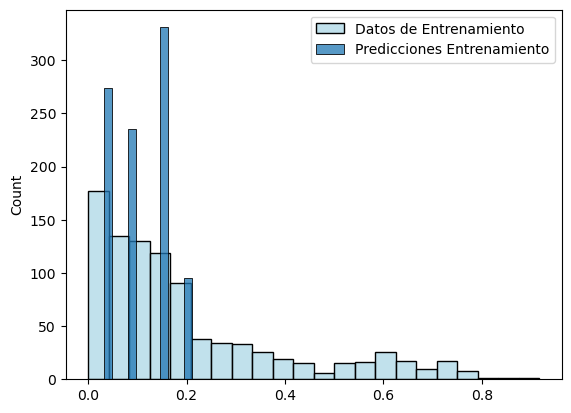

In [32]:
r2_train_4 = r2_score(y_train_desc, pred_train_desc_4)
mae_train_4 = mean_absolute_error(y_train_desc, pred_train_desc_4)
rmse_train_4 = root_mean_squared_error(y_train_desc, pred_train_desc_4)
mape_train_4 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_4)

print(f'R2 entrenamiento: {r2_train_4}')
print(f'MAE entrenamiento: {mae_train_4}')
print(f'RMSE entrenamiento: {rmse_train_4}')
print(f'MAPE entrenamiento: {mape_train_4}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_4.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.0708882937571802
MAE prueba: 0.10019732531707576
RMSE prueba: 0.1953253292478221
MAPE prueba: 1.0008332550864418


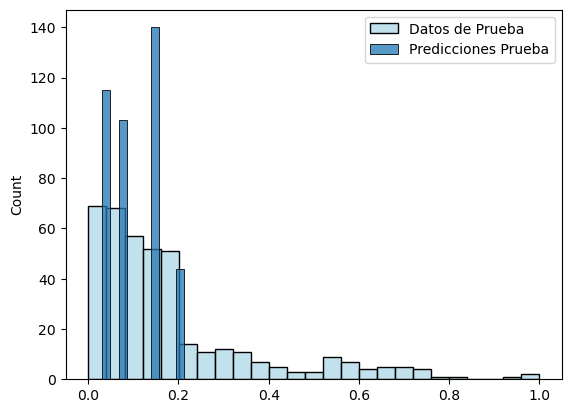

In [33]:
r2_test_4 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_4 = mean_absolute_error(y_test_desc, pred_test_desc_4)
rmse_test_4 = root_mean_squared_error(y_test_desc, pred_test_desc_4)
mape_test_4 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_4)

print(f'R2 prueba: {r2_test_4}')
print(f'MAE prueba: {mae_test_4}')
print(f'RMSE prueba: {rmse_test_4}')
print(f'MAPE prueba: {mape_test_4}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_4.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bosques Aleatorios

In [34]:
from sklearn.ensemble import RandomForestRegressor

In [35]:
modelo_5 = RandomForestRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'],
              'max_depth': [None, 5, 10, 20], 'max_leaf_nodes': [None, 2, 3, 4], 'n_estimators': [100, 200, 300]}
reg_5 = GridSearchCV(modelo_5, param_grid, cv=3, scoring= scorer_wmape, n_jobs=-1)
reg_5.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_5.cv_results_['params']), 
                        pd.DataFrame(reg_5.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,n_estimators,MAPE
153,absolute_error,NaN,4.0,100,-0.579442
177,absolute_error,10.0,4.0,100,-0.579442
165,absolute_error,5.0,4.0,100,-0.579442
189,absolute_error,20.0,4.0,100,-0.579442
191,absolute_error,20.0,4.0,300,-0.579449
...,...,...,...,...,...
182,absolute_error,20.0,NaN,300,-0.757427
145,absolute_error,NaN,NaN,200,-0.757842
181,absolute_error,20.0,NaN,200,-0.757986
144,absolute_error,NaN,NaN,100,-0.759407


In [36]:
modelo_5_final = reg_5.best_estimator_
modelo_5_final

RandomForestRegressor(criterion='absolute_error', max_leaf_nodes=4,
                      random_state=123)

In [37]:
pred_train_5 = modelo_5_final.predict(X_train)
pred_test_5 = modelo_5_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_5 = pred_train_5 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_5 = pred_test_5 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.12268364870642867
MAE entrenamiento: 0.11275215098471401
RMSE entrenamiento: 0.2065347609689065
MAPE entrenamiento: 1.111283766674078


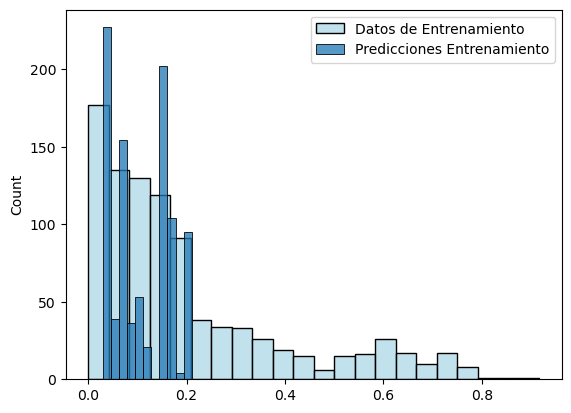

In [38]:
r2_train_5 = r2_score(y_train_desc, pred_train_desc_5)
mae_train_5 = mean_absolute_error(y_train_desc, pred_train_desc_5)
rmse_train_5 = root_mean_squared_error(y_train_desc, pred_train_desc_5)
mape_train_5 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_5)

print(f'R2 entrenamiento: {r2_train_5}')
print(f'MAE entrenamiento: {mae_train_5}')
print(f'RMSE entrenamiento: {rmse_train_5}')
print(f'MAPE entrenamiento: {mape_train_5}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_5.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.0708882937571802
MAE prueba: 0.09767216113066805
RMSE prueba: 0.19436198508892416
MAPE prueba: 1.0932553535200662


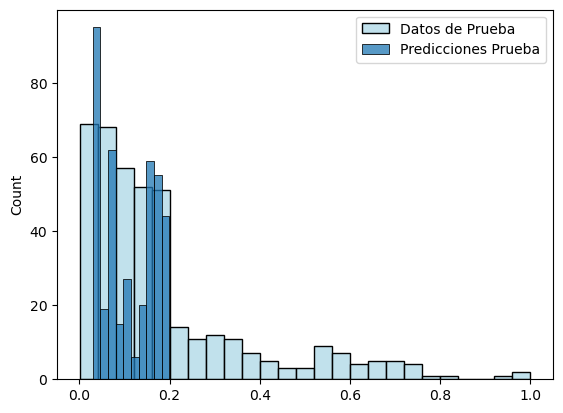

In [39]:
r2_test_5 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_5 = mean_absolute_error(y_test_desc, pred_test_desc_5)
rmse_test_5 = root_mean_squared_error(y_test_desc, pred_test_desc_5)
mape_test_5 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_5)

print(f'R2 prueba: {r2_test_5}')
print(f'MAE prueba: {mae_test_5}')
print(f'RMSE prueba: {rmse_test_5}')
print(f'MAPE prueba: {mape_test_5}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_5.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Adaptative Boosting

In [40]:
from sklearn.ensemble import AdaBoostRegressor

In [42]:
modelo_6 = AdaBoostRegressor()
param_grid = {'estimator': [DecisionTreeRegressor(), KNeighborsRegressor()], 'n_estimators': [100, 200, 400], 'loss': ['linear', 'square', 'exponential'], 'learning_rate': [0.001, 0.1, 1, 10]}
reg_6 = GridSearchCV(modelo_6, param_grid, cv=3, scoring=scorer_wmape)
reg_6.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_6.cv_results_['params']), 
                        pd.DataFrame(reg_6.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,estimator,learning_rate,loss,n_estimators,MAPE
8,DecisionTreeRegressor(),0.001,exponential,400,-0.624787
6,DecisionTreeRegressor(),0.001,exponential,100,-0.626913
5,DecisionTreeRegressor(),0.001,square,400,-0.627296
0,DecisionTreeRegressor(),0.001,linear,100,-0.627356
3,DecisionTreeRegressor(),0.001,square,100,-0.627541
...,...,...,...,...,...
32,DecisionTreeRegressor(),10.000,square,400,-3.542142
30,DecisionTreeRegressor(),10.000,square,100,-3.542142
66,KNeighborsRegressor(),10.000,square,100,-3.542142
67,KNeighborsRegressor(),10.000,square,200,-3.542142


In [43]:
modelo_6_final = reg_6.best_estimator_
modelo_6_final

AdaBoostRegressor(estimator=DecisionTreeRegressor(), learning_rate=0.001,
                  loss='exponential', n_estimators=400)

In [44]:
pred_train_6 = modelo_6_final.predict(X_train)
pred_test_6 = modelo_6_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_6 = pred_train_6 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_6 = pred_test_6 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245660432
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124091143
WMAPE entrenamiento: 0.00107519242595804


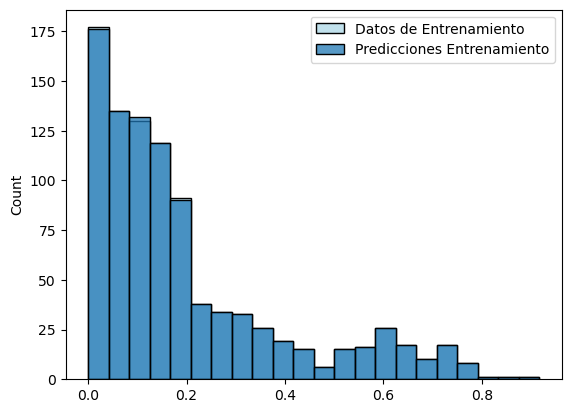

In [48]:
r2_train_6 = r2_score(y_train_desc, pred_train_desc_6)
mae_train_6 = mean_absolute_error(y_train_desc, pred_train_desc_6)
rmse_train_6 = root_mean_squared_error(y_train_desc, pred_train_desc_6)
mape_train_6 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_6)
wmape_train_6 = wmape(y_train_desc, pred_train_desc_6)

print(f'R2 entrenamiento: {r2_train_6}')
print(f'MAE entrenamiento: {mae_train_6}')
print(f'RMSE entrenamiento: {rmse_train_6}')
print(f'MAPE entrenamiento: {mape_train_6}')
print(f'WMAPE entrenamiento: {wmape_train_6}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_6.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.4800180314168543
MAE prueba: 0.13047065405873157
RMSE prueba: 0.22962543007885713
MAPE prueba: 4.53159152026358
WMAPE prueba: 0.7081658689972649


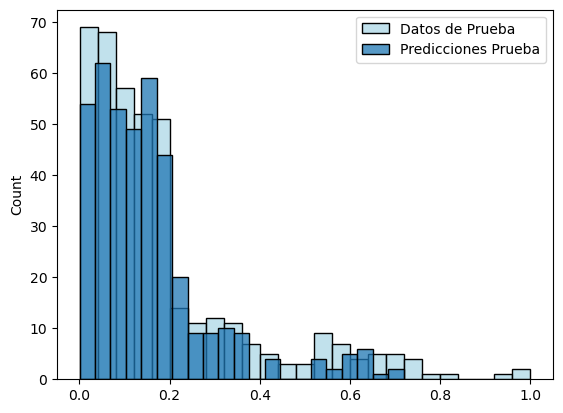

In [49]:
r2_test_6 = r2_score(y_test_desc, pred_test_desc_6)
mae_test_6 = mean_absolute_error(y_test_desc, pred_test_desc_6)
rmse_test_6 = root_mean_squared_error(y_test_desc, pred_test_desc_6)
mape_test_6 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_6)
wmape_test_6 = wmape(y_test_desc, pred_test_desc_6)

print(f'R2 prueba: {r2_test_6}')
print(f'MAE prueba: {mae_test_6}')
print(f'RMSE prueba: {rmse_test_6}')
print(f'MAPE prueba: {mape_test_6}')
print(f'WMAPE prueba: {wmape_test_6}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_6.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### GradientBoosting

In [51]:
from sklearn.ensemble import GradientBoostingRegressor

In [52]:
modelo_7 = GradientBoostingRegressor()
# loss: ['squared_error', 'absolute_error', 'huber', 'quantile']
param_grid = {'loss': ['squared_error', 'absolute_error', 'huber', 'quantile'], 'n_estimators': [100, 200, 300, 900], 'criterion': ['friedman_mse', 'squared_error']}
reg_7 = GridSearchCV(modelo_7, param_grid, cv=3, scoring=scorer_wmape)
reg_7.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_7.cv_results_['params']), 
                        pd.DataFrame(reg_7.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,loss,n_estimators,MAPE
7,friedman_mse,absolute_error,900,-0.554557
21,squared_error,absolute_error,200,-0.555465
22,squared_error,absolute_error,300,-0.556360
4,friedman_mse,absolute_error,100,-0.557162
20,squared_error,absolute_error,100,-0.557288
5,friedman_mse,absolute_error,200,-0.558050
6,friedman_mse,absolute_error,300,-0.559741
23,squared_error,absolute_error,900,-0.561535
24,squared_error,huber,100,-0.719070
8,friedman_mse,huber,100,-0.720976


In [53]:
modelo_7_final = reg_7.best_estimator_
modelo_7_final

GradientBoostingRegressor(loss='absolute_error', n_estimators=900)

In [54]:
pred_train_7 = modelo_7_final.predict(X_train)
pred_test_7 = modelo_7_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_7 = pred_train_7 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_7 = pred_test_7 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.09704761958381258
MAE entrenamiento: 0.1025761339049244
RMSE entrenamiento: 0.2041630746000706
MAPE entrenamiento: 0.5684560758831565
WMAPE entrenamiento: 0.5168561508733971


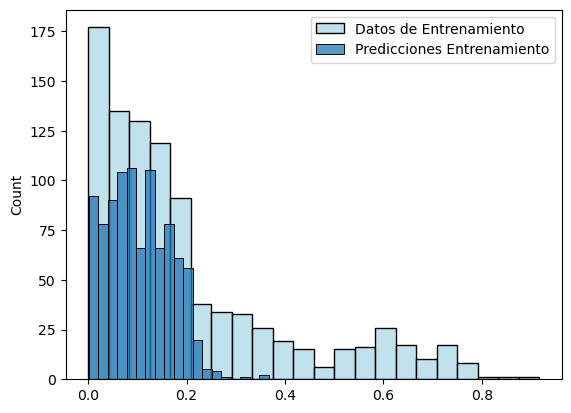

In [56]:
r2_train_7 = r2_score(y_train_desc, pred_train_desc_7)
mae_train_7 = mean_absolute_error(y_train_desc, pred_train_desc_7)
rmse_train_7 = root_mean_squared_error(y_train_desc, pred_train_desc_7)
mape_train_7 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_7)
wmape_train_7 = wmape(y_train_desc, pred_train_desc_7)

print(f'R2 entrenamiento: {r2_train_7}')
print(f'MAE entrenamiento: {mae_train_7}')
print(f'RMSE entrenamiento: {rmse_train_7}')
print(f'MAPE entrenamiento: {mape_train_7}')
print(f'WMAPE entrenamiento: {wmape_train_7}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_7.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.09295966197974082
MAE prueba: 0.09479358993388434
RMSE prueba: 0.19732792373104033
MAPE prueba: 2.20805452877115
WMAPE prueba: 0.5145186515327892


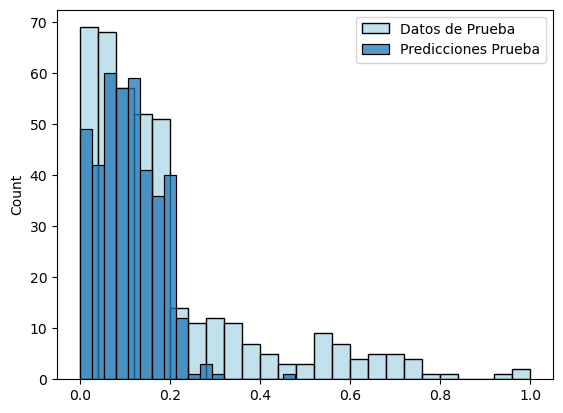

In [58]:
r2_test_7 = r2_score(y_test_desc, pred_test_desc_7)
mae_test_7 = mean_absolute_error(y_test_desc, pred_test_desc_7)
rmse_test_7 = root_mean_squared_error(y_test_desc, pred_test_desc_7)
mape_test_7 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_7)
wmape_test_7 = wmape(y_test_desc, pred_test_desc_7)

print(f'R2 prueba: {r2_test_7}')
print(f'MAE prueba: {mae_test_7}')
print(f'RMSE prueba: {rmse_test_7}')
print(f'MAPE prueba: {mape_test_7}')
print(f'WMAPE prueba: {wmape_test_7}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_7.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### CatBoost Regressor

In [59]:
from catboost import CatBoostRegressor

In [60]:
modelo_8 = CatBoostRegressor()
param_grid = {'iterations': [100, 200, 500], 'depth': [4, 6, 8], 'learning_rate': [0.01, 0.1, 0.5, 1], 'l2_leaf_reg': [1, 3, 5]}
reg_8 = GridSearchCV(modelo_8, param_grid, cv=3, scoring=scorer_wmape, n_jobs=-1)
reg_8.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_8.cv_results_['params']), 
                        pd.DataFrame(reg_8.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

0:	learn: 0.1929157	total: 58.2ms	remaining: 5.76s
0:	learn: 0.2011632	total: 58.2ms	remaining: 5.76s
0:	learn: 0.1914571	total: 58.2ms	remaining: 5.76s
0:	learn: 0.2035782	total: 58.2ms	remaining: 5.76s
0:	learn: 0.1884358	total: 58ms	remaining: 5.75s
1:	learn: 0.1891939	total: 58.5ms	remaining: 2.87s
1:	learn: 0.1912652	total: 58.5ms	remaining: 2.86s
0:	learn: 0.1820452	total: 58.2ms	remaining: 5.76s
1:	learn: 0.1992532	total: 58.5ms	remaining: 2.86s
1:	learn: 0.2033545	total: 58.6ms	remaining: 2.87s
1:	learn: 0.1882610	total: 58.7ms	remaining: 2.88s
1:	learn: 0.1771523	total: 58.5ms	remaining: 2.86s
2:	learn: 0.1972963	total: 58.7ms	remaining: 1.9s
2:	learn: 0.2030911	total: 58.9ms	remaining: 1.9s
2:	learn: 0.1880502	total: 59ms	remaining: 1.91s
0:	learn: 0.1893215	total: 58.2ms	remaining: 5.76s
2:	learn: 0.1744729	total: 58.7ms	remaining: 1.9s
3:	learn: 0.1954019	total: 59ms	remaining: 1.42s
3:	learn: 0.2028337	total: 59.1ms	remaining: 1.42s
0:	learn: 0.1863865	total: 58.2ms	remain

,depth,iterations,l2_leaf_reg,learning_rate,MAPE
81,8,100,5,0.10,-0.732986
93,8,200,5,0.10,-0.735031
96,8,500,1,0.01,-0.735357
100,8,500,3,0.01,-0.736461
77,8,100,3,0.10,-0.737018
...,...,...,...,...,...
63,6,500,1,1.00,-0.892678
3,4,100,1,1.00,-0.905633
31,4,500,3,1.00,-0.906380
15,4,200,1,1.00,-0.935928


In [61]:
modelo_8_final = reg_8.best_estimator_
modelo_8_final

In [62]:
pred_train_8 = modelo_8_final.predict(X_train)
pred_test_8 = modelo_8_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_8 = pred_train_8 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_8 = pred_test_8 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.5178569588842925
MAE entrenamiento: 0.10667048286156326
RMSE entrenamiento: 0.13534817651299577
MAPE entrenamiento: 2.6111976040401963
WMAPE entrenamiento: 0.5374865778694303


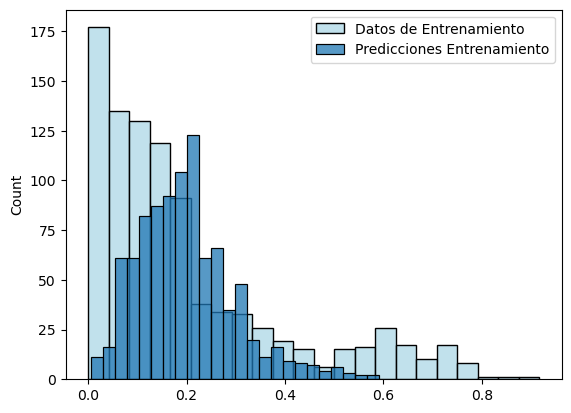

In [63]:
r2_train_8 = r2_score(y_train_desc, pred_train_desc_8)
mae_train_8 = mean_absolute_error(y_train_desc, pred_train_desc_8)
rmse_train_8 = root_mean_squared_error(y_train_desc, pred_train_desc_8)
mape_train_8 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_8)
wmape_train_8 = wmape(y_train_desc, pred_train_desc_8)

print(f'R2 entrenamiento: {r2_train_8}')
print(f'MAE entrenamiento: {mae_train_8}')
print(f'RMSE entrenamiento: {rmse_train_8}')
print(f'MAPE entrenamiento: {mape_train_8}')
print(f'WMAPE entrenamiento: {wmape_train_8}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_8.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.012910255108033453
MAE prueba: 0.1415077513671579
RMSE prueba: 0.1875274289752697
MAPE prueba: 4.211079082263974
WMAPE prueba: 0.7680727933782118


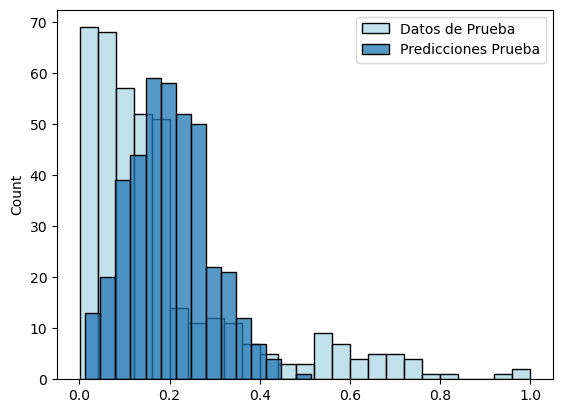

In [64]:
r2_test_8 = r2_score(y_test_desc, pred_test_desc_8)
mae_test_8 = mean_absolute_error(y_test_desc, pred_test_desc_8)
rmse_test_8 = root_mean_squared_error(y_test_desc, pred_test_desc_8)
mape_test_8 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_8)
wmape_test_8 = wmape(y_test_desc, pred_test_desc_8)

print(f'R2 prueba: {r2_test_8}')
print(f'MAE prueba: {mae_test_8}')
print(f'RMSE prueba: {rmse_test_8}')
print(f'MAPE prueba: {mape_test_8}')
print(f'WMAPE prueba: {wmape_test_8}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_8.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Huber Regressor

In [65]:
from sklearn.linear_model import HuberRegressor

In [66]:
modelo_9 = HuberRegressor()
modelo_9.fit(X_train, y_train)

HuberRegressor()

In [67]:
pred_train_9 = modelo_9.predict(X_train)
pred_test_9 = modelo_9.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_9 = pred_train_9 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_9 = pred_test_9 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: -0.1571064006739269
MAE entrenamiento: 0.10994337186701576
RMSE entrenamiento: 0.20967715034625997
MAPE entrenamiento: 0.3754047384178349
WMAPE entrenamiento: 0.5539778682817007


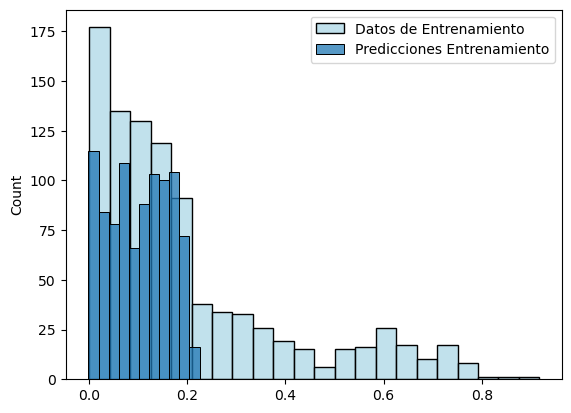

In [68]:
r2_train_9 = r2_score(y_train_desc, pred_train_desc_9)
mae_train_9 = mean_absolute_error(y_train_desc, pred_train_desc_9)
rmse_train_9 = root_mean_squared_error(y_train_desc, pred_train_desc_9)
mape_train_9 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_9)
wmape_train_9 = wmape(y_train_desc, pred_train_desc_9)

print(f'R2 entrenamiento: {r2_train_9}')
print(f'MAE entrenamiento: {mae_train_9}')
print(f'RMSE entrenamiento: {rmse_train_9}')
print(f'MAPE entrenamiento: {mape_train_9}')
print(f'WMAPE entrenamiento: {wmape_train_9}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_9.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.07865012338291644
MAE prueba: 0.09455416291788643
RMSE prueba: 0.19603191306957052
MAPE prueba: 0.3386697103244227
WMAPE prueba: 0.5132190946165706


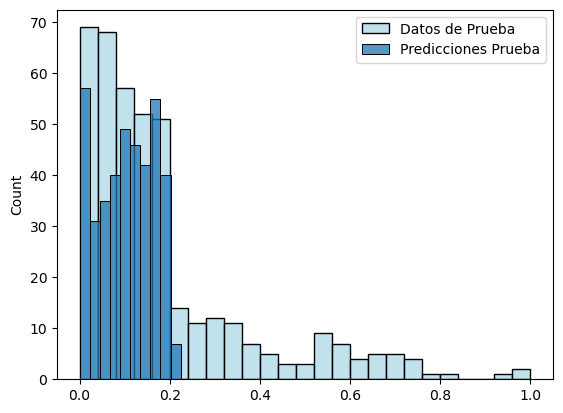

In [69]:
r2_test_9 = r2_score(y_test_desc, pred_test_desc_9)
mae_test_9 = mean_absolute_error(y_test_desc, pred_test_desc_9)
rmse_test_9 = root_mean_squared_error(y_test_desc, pred_test_desc_9)
mape_test_9 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_9)
wmape_test_9 = wmape(y_test_desc, pred_test_desc_9)

print(f'R2 prueba: {r2_test_9}')
print(f'MAE prueba: {mae_test_9}')
print(f'RMSE prueba: {rmse_test_9}')
print(f'MAPE prueba: {mape_test_9}')
print(f'WMAPE prueba: {wmape_test_9}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_9.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### LightGBM Regressor

In [70]:
from lightgbm import LGBMRegressor

In [71]:
modelo_10 = LGBMRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'learning_rate': [0.01, 0.1, 0.5, 1], 'num_leaves': [20, 30, 40, 50], 'max_depth': [4, 6, 8]}
reg_10 = GridSearchCV(modelo_10, param_grid, cv=3, scoring=scorer_wmape, n_jobs=-1)
reg_10.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_10.cv_results_['params']), 
                        pd.DataFrame(reg_10.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000960 seconds.
You can set `force_col_wise=true` to remove the overhead.[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001216 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001425 seconds.
You can set `force_col_wise=true` to remove the overhead.[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001357 seconds.
You can set `force_col_wi

,learning_rate,max_depth,n_estimators,num_leaves,MAPE
35,0.01,8,100,50,-0.751229
34,0.01,8,100,40,-0.751229
33,0.01,8,100,30,-0.751229
16,0.01,6,100,20,-0.751400
19,0.01,6,100,50,-0.751642
...,...,...,...,...,...
175,1.00,6,900,50,-0.943825
174,1.00,6,900,40,-0.943825
173,1.00,6,900,30,-0.943825
168,1.00,6,300,20,-0.949652


In [72]:
modelo_10_final = reg_10.best_estimator_
modelo_10_final

LGBMRegressor(learning_rate=0.01, max_depth=8, num_leaves=30, random_state=123)

In [73]:
pred_train_10 = modelo_10_final.predict(X_train)
pred_test_10 = modelo_10_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_10 = pred_train_10 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_10 = pred_test_10 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.22855333018829926
MAE entrenamiento: 0.13587900529889718
RMSE entrenamiento: 0.171205381587321
MAPE entrenamiento: 5.14310760026766
WMAPE entrenamiento: 0.6846612071418922


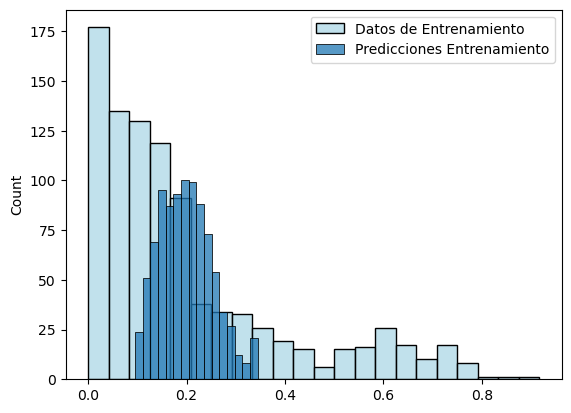

In [74]:
r2_train_10 = r2_score(y_train_desc, pred_train_desc_10)
mae_train_10 = mean_absolute_error(y_train_desc, pred_train_desc_10)
rmse_train_10 = root_mean_squared_error(y_train_desc, pred_train_desc_10)
mape_train_10 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_10)
wmape_train_10 = wmape(y_train_desc, pred_train_desc_10)

print(f'R2 entrenamiento: {r2_train_10}')
print(f'MAE entrenamiento: {mae_train_10}')
print(f'RMSE entrenamiento: {rmse_train_10}')
print(f'MAPE entrenamiento: {mape_train_10}')
print(f'WMAPE entrenamiento: {wmape_train_10}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_10.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.06581691577548154
MAE prueba: 0.14178835757726016
RMSE prueba: 0.18243261314507817
MAPE prueba: 5.548333155081504
WMAPE prueba: 0.7695958618571485


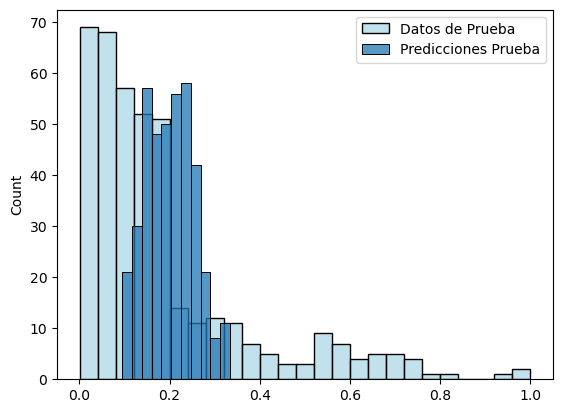

In [75]:
r2_test_10 = r2_score(y_test_desc, pred_test_desc_10)
mae_test_10 = mean_absolute_error(y_test_desc, pred_test_desc_10)
rmse_test_10 = root_mean_squared_error(y_test_desc, pred_test_desc_10)
mape_test_10 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_10)
wmape_test_10 = wmape(y_test_desc, pred_test_desc_10)

print(f'R2 prueba: {r2_test_10}')
print(f'MAE prueba: {mae_test_10}')
print(f'RMSE prueba: {rmse_test_10}')
print(f'MAPE prueba: {mape_test_10}')
print(f'WMAPE prueba: {wmape_test_10}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_10.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bayesian Ridge

In [76]:
from sklearn.linear_model import BayesianRidge

In [77]:
modelo_11 = BayesianRidge()
modelo_11.fit(X_train, y_train)

BayesianRidge()

In [78]:
pred_train_11 = modelo_11.predict(X_train)
pred_test_11 = modelo_11.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_11 = pred_train_11 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_11 = pred_test_11 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.13071174006249353
MAE entrenamiento: 0.14627968136538136
RMSE entrenamiento: 0.18173825963133847
MAPE entrenamiento: 4.546204652870611
WMAPE entrenamiento: 0.73706768020303


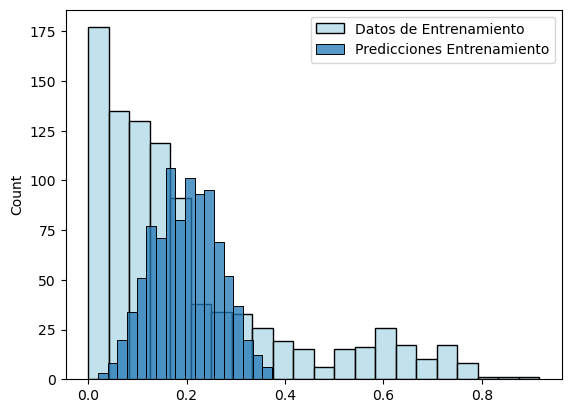

In [79]:
r2_train_11 = r2_score(y_train_desc, pred_train_desc_11)
mae_train_11 = mean_absolute_error(y_train_desc, pred_train_desc_11)
rmse_train_11 = root_mean_squared_error(y_train_desc, pred_train_desc_11)
mape_train_11 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_11)
wmape_train_11 = wmape(y_train_desc, pred_train_desc_11)

print(f'R2 entrenamiento: {r2_train_11}')
print(f'MAE entrenamiento: {mae_train_11}')
print(f'RMSE entrenamiento: {rmse_train_11}')
print(f'MAPE entrenamiento: {mape_train_11}')
print(f'WMAPE entrenamiento: {wmape_train_11}')


sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_11.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.10581430050280627
MAE prueba: 0.13933151029206647
RMSE prueba: 0.17848443116279783
MAPE prueba: 4.658872974197279
WMAPE prueba: 0.7562606378923052


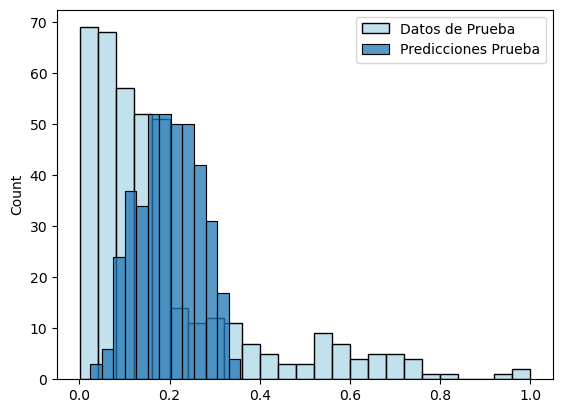

In [80]:
r2_test_11 = r2_score(y_test_desc, pred_test_desc_11)
mae_test_11 = mean_absolute_error(y_test_desc, pred_test_desc_11)
rmse_test_11 = root_mean_squared_error(y_test_desc, pred_test_desc_11)
mape_test_11 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_11)
wmape_test_11 = wmape(y_test_desc, pred_test_desc_11)

print(f'R2 prueba: {r2_test_11}')
print(f'MAE prueba: {mae_test_11}')
print(f'RMSE prueba: {rmse_test_11}')
print(f'MAPE prueba: {mape_test_11}')
print(f'WMAPE prueba: {wmape_test_11}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_11.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Extra Trees Regressor

In [81]:
from sklearn.ensemble import ExtraTreesRegressor

In [82]:
modelo_12 = ExtraTreesRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'criterion': ['squared_error', 'absolute_error', 'poisson'], 'max_features': ['sqrt', 'log2', None], 'bootstrap': [False]}
reg_12 = GridSearchCV(modelo_12, param_grid, cv=3, scoring=scorer_wmape, n_jobs=-1)
reg_12.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_12.cv_results_['params']), 
                        pd.DataFrame(reg_12.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,bootstrap,criterion,max_features,n_estimators,MAPE
30,False,poisson,log2,300,-0.715193
26,False,poisson,sqrt,300,-0.715193
24,False,poisson,sqrt,100,-0.716069
28,False,poisson,log2,100,-0.716069
25,False,poisson,sqrt,200,-0.716476
29,False,poisson,log2,200,-0.716476
27,False,poisson,sqrt,900,-0.716677
31,False,poisson,log2,900,-0.716677
6,False,squared_error,log2,300,-0.716773
2,False,squared_error,sqrt,300,-0.716773


In [83]:
modelo_12_final = reg_12.best_estimator_
modelo_12_final

ExtraTreesRegressor(criterion='poisson', max_features='sqrt', n_estimators=300,
                    random_state=123)

In [84]:
pred_train_12 = modelo_12_final.predict(X_train)
pred_test_12 = modelo_12_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_12 = pred_train_12 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_12 = pred_test_12 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245730908
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124094597
WMAPE entrenamiento: 0.001075192425961591


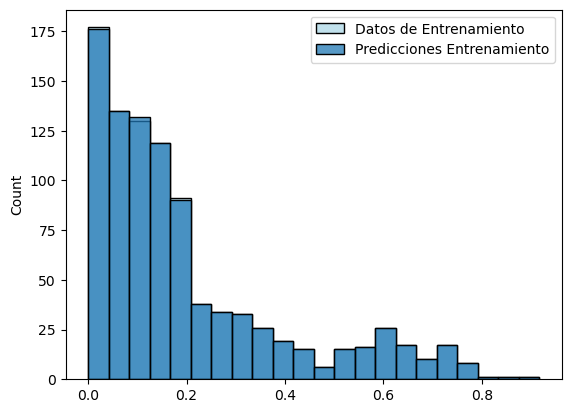

In [85]:
r2_train_12 = r2_score(y_train_desc, pred_train_desc_12)
mae_train_12 = mean_absolute_error(y_train_desc, pred_train_desc_12)
rmse_train_12 = root_mean_squared_error(y_train_desc, pred_train_desc_12)
mape_train_12 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_12)
wmape_train_12 = wmape(y_train_desc, pred_train_desc_12)

print(f'R2 entrenamiento: {r2_train_12}')
print(f'MAE entrenamiento: {mae_train_12}')
print(f'RMSE entrenamiento: {rmse_train_12}')
print(f'MAPE entrenamiento: {mape_train_12}')
print(f'WMAPE entrenamiento: {wmape_train_12}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_12.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: -0.2252889405874019
MAE prueba: 0.14660899338486133
RMSE prueba: 0.20893237269378157
MAPE prueba: 4.461974950211406
WMAPE prueba: 0.7957612073935667


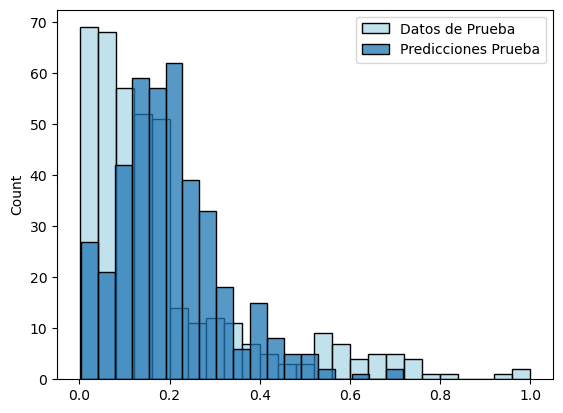

Exception ignored in: <function ResourceTracker.__del__ at 0x110063100>
Traceback (most recent call last):
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x107eaf100>
Traceback (most recent call last):
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/Users/loperatomas410/anaconda3/envs/data/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _sto

In [ ]:
r2_test_12 = r2_score(y_test_desc, pred_test_desc_12)
mae_test_12 = mean_absolute_error(y_test_desc, pred_test_desc_12)
rmse_test_12 = root_mean_squared_error(y_test_desc, pred_test_desc_12)
mape_test_12 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_12)
wmape_test_12 = wmape(y_test_desc, pred_test_desc_12)

print(f'R2 prueba: {r2_test_12}')
print(f'MAE prueba: {mae_test_12}')
print(f'RMSE prueba: {rmse_test_12}')
print(f'MAPE prueba: {mape_test_12}')
print(f'WMAPE prueba: {wmape_test_12}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_12.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()